In [9]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification
import pandas as pd
from sklearn.model_selection import train_test_split

tokenizer = DistilBertTokenizer.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")
model = DistilBertForSequenceClassification.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")


In [98]:
base_csv = './data/IMDB Dataset.csv'
df = pd.read_csv(base_csv)
df.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [99]:
df['label_convert'] = list(map(lambda x: 1 if x == 'positive' else 0, df['sentiment']))

In [100]:
X_train, X_test, y_train, y_test = train_test_split(df['review'], df['label_convert'], test_size=0.2, random_state=42, shuffle=True)

In [101]:
res = pd.DataFrame({
    'x': X_test,
    'y': y_test
})
res = res.reset_index(drop=True)
res.head()

,x,y
0,I really liked this Summerslam due to the look...,1
1,Not many television shows appeal to quite as m...,1
2,The film quickly gets to a major chase scene w...,0
3,Jane Austen would definitely approve of this o...,1
4,Expectations were somewhat high for me when I ...,0


In [102]:
def predict(sentence):
    inputs = tokenizer(sentence, return_tensors="pt")
    inputs = tokenizer(sentence, padding=True, truncation=True , max_length=512, add_special_tokens = True, return_tensors="pt")
    print(inputs)
    with torch.no_grad():
        logits = model(**inputs).logits
    predicted_class_id = logits.argmax().item()
    return model.config.id2label[predicted_class_id]
    
    
res['predict'] = list(map(predict, res['x']))

{'input_ids': tensor([[  101,  1045,  2428,  4669,  2023, 10945, 10278,  2349,  2000,  1996,
          2298,  1997,  1996,  5196,  1010,  1996, 14694,  1998,  2074,  1996,
          2298,  3452,  2001,  5875,  2000,  2033,  2005,  2070,  3114,  1012,
          4312,  2015,  1010,  2023,  2071,  2031,  2042,  2028,  1997,  1996,
          2190, 10945, 10278,  1005,  1055,  2412,  2065,  1996, 16779,  2134,
          1005,  1056,  2031, 17244, 11320,  4590,  1999,  1996,  2364,  2724,
          2114, 28758,  9759,  2532,  1010,  2085,  2005,  2009,  1005,  1055,
          2051,  2009,  2001,  7929,  2000,  2031,  1037,  4121,  6638,  2158,
          5443,  1037,  2844,  2158,  2021,  1045,  1005,  1049,  5580,  2335,
          2031,  2904,  1012,  2009,  2001,  1037,  6659,  2364,  2724,  2074,
          2066,  2296,  2674, 11320,  4590,  2003,  1999,  2003,  6659,  1012,
          2060,  3503,  2006,  1996,  4003,  2020, 15082, 12716,  5443,  6945,
          4487, 11607,  3366,  1010, 2

In [103]:
res['predict_convert'] = list(map(lambda x: 1 if x == 'POSITIVE' else 0, res['predict']))

In [89]:
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix



# Calculate Accuracy
accuracy = accuracy_score(res['y'], res['predict_convert'])
print(f"Accuracy: {accuracy:.2f}")

# Generate Confusion Matrix
conf_matrix = confusion_matrix(res['y'], res['predict_convert'])
print("Confusion Matrix:")
print(conf_matrix)

Accuracy: 0.79
Confusion Matrix:
[[4516  445]
 [1656 3383]]


In [97]:
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix



# Calculate Accuracy
accuracy = accuracy_score(res['y'], res['predict_convert'])
print(f"Accuracy: {accuracy:.2f}")

# Generate Confusion Matrix
conf_matrix = confusion_matrix(res['y'], res['predict_convert'])
print("Confusion Matrix:")
print(conf_matrix)

Accuracy: 0.81
Confusion Matrix:
[[4110  851]
 [1028 4011]]


Accuracy: 0.89


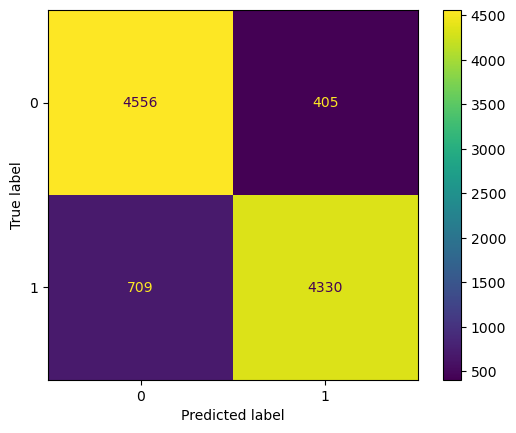

In [105]:
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt


# Calculate Accuracy
accuracy = accuracy_score(res['y'], res['predict_convert'])
print(f"Accuracy: {accuracy:.2f}")

# Generate Confusion Matrix
conf_matrix = confusion_matrix(res['y'], res['predict_convert'])
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot()
plt.show()